# 1.1

In [7]:
# Importing Libraries
import numpy as np
import cv2
import urllib.request
from google.colab.patches import cv2_imshow

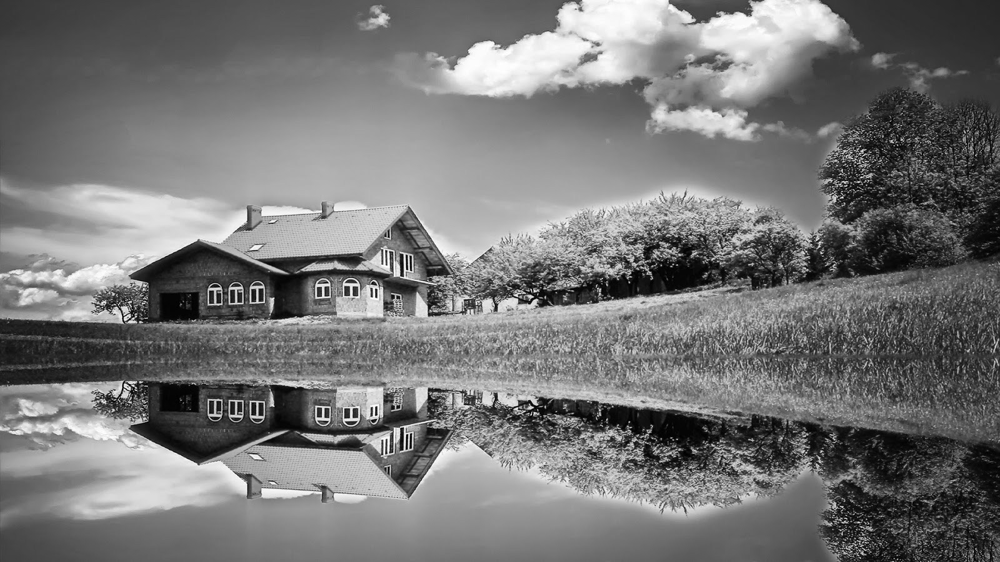

In [14]:
# Loading the Image
image = cv2.imread("img.jpg", cv2.IMREAD_GRAYSCALE)
cv2_imshow(image)

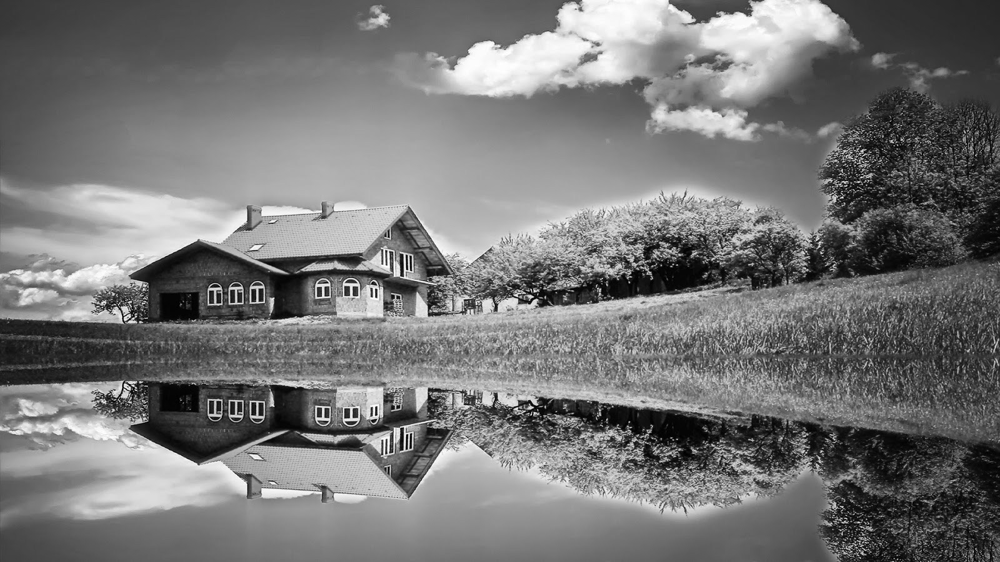

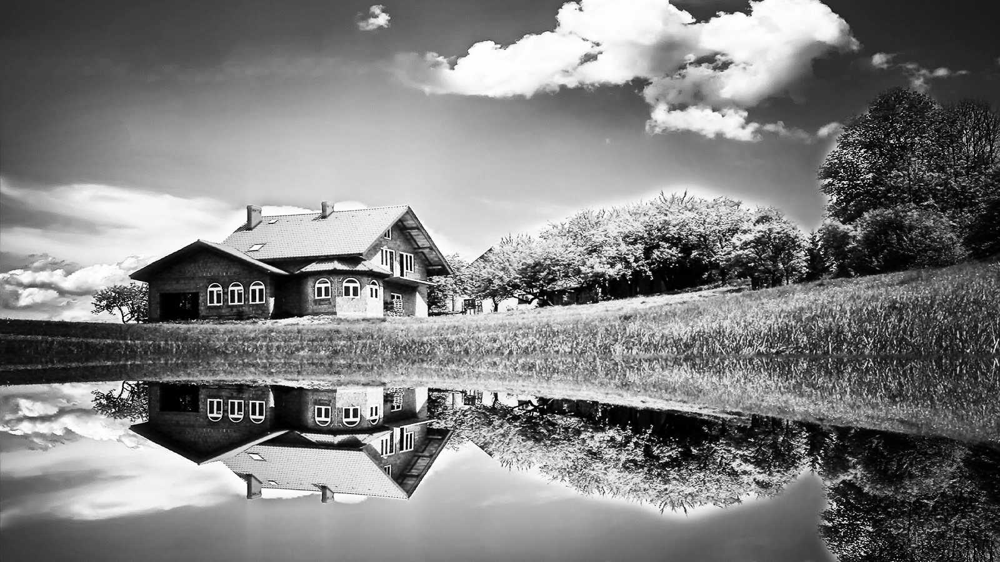

In [16]:
#histogram
histogram = np.zeros(256, dtype=int)
for i in range(image.shape[0]):
    for j in range(image.shape[1]):
        histogram[image[i, j]] += 1

#cummulative
cumulative_histogram = np.cumsum(histogram)

# Normalizing
normalized_cumulative_histogram = cumulative_histogram / float(np.sum(histogram))

# Equaliziation
equalized_image = np.zeros(image.shape, dtype=np.uint8)
for i in range(image.shape[0]):
    for j in range(image.shape[1]):
        equalized_image[i, j] = int(255 * normalized_cumulative_histogram[image[i, j]])

cv2_imshow(image)
cv2_imshow(equalized_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [17]:
print("Original image histogram:")
print(histogram)

print("Equalized image histogram:")
equalized_histogram = np.histogram(equalized_image, bins=256, range=(0, 256))[0]
print(equalized_histogram)

Original image histogram:
[  648   328   485   778  1584  2882  2677  2512  2660  2705  3113  3316
  3531  3829  4100  4412  4471  4466  4376  4408  4344  4328  4329  4255
  4143  4284  4280  4288  4494  4534  4524  4474  4649  4750  4719  4527
  4799  4786  4594  4909  5054  5244  5923  5510  5732  5786  5685  5669
  7005  5912  5891  6444  5697  5347  5644  7220  6250  5619  5491  6153
  5687  5800  5715  6110  5817  5773  5680  6302  6604  6310  5698  6185
  6520  7470  7370  7095  6909  7425  7873  7054  6423  6754  7220  7848
  7561  7345  7631  7301  7816  7687  7934  7652  8053  7590  8082  8429
  8932  8862  9256  9424  9402  9410  9265  9022  8888  9113  9515  9282
  9305  9258  8998  9335  9002  9053  9446  9735  9891 10118 10375 10364
 10096 10001  9644  9199  8529  8198  8189  8469  8462  8565  8429  8233
  8000  8178  8031  8054  8254  8444  8844  8905  8722  8805  8691  8550
  8449  8241  7938  7538  7273  7194  7317  7352  7185  6966  6955  6917
  7008  6756  6854  7086 

# 1.2

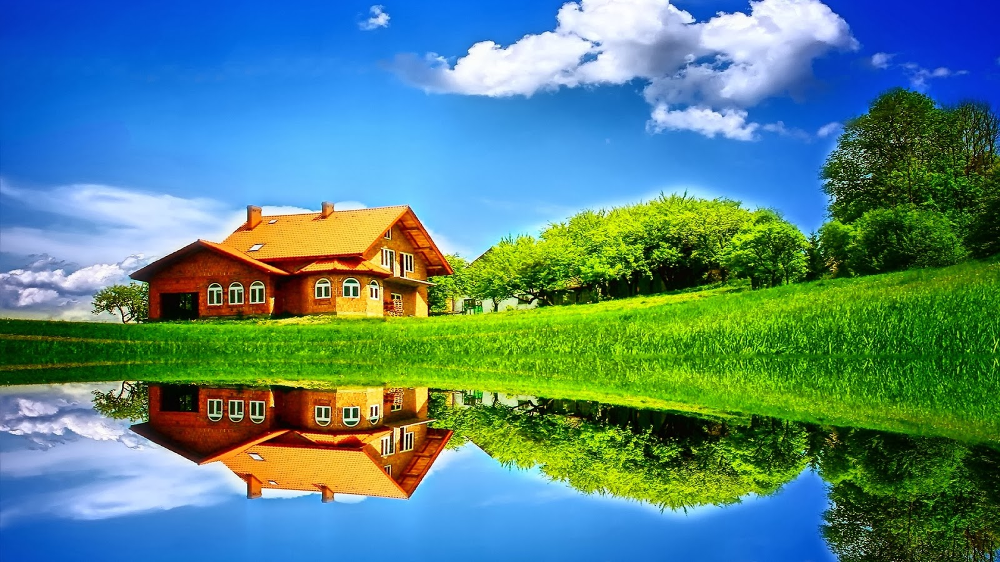

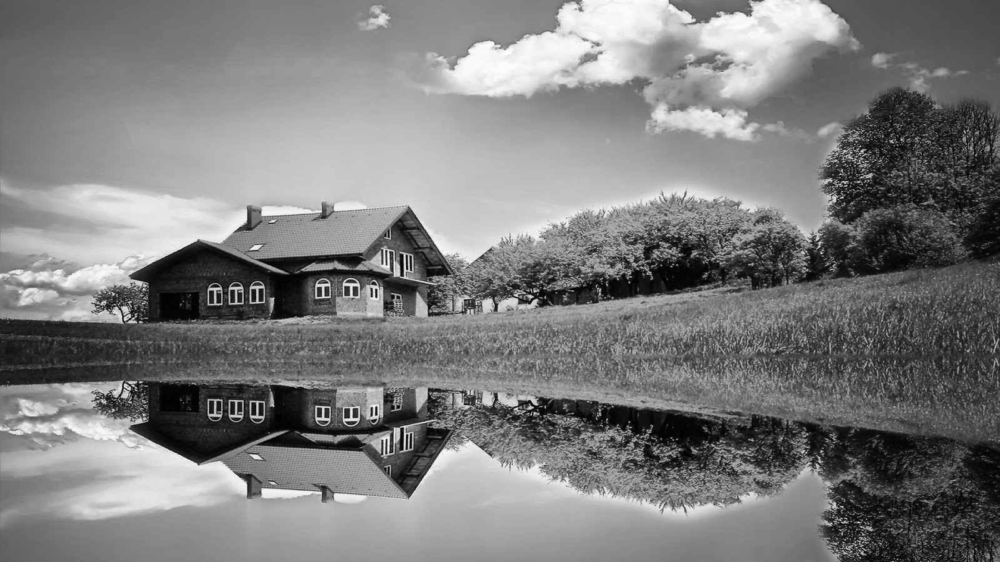

In [20]:
def rgb2gray(image):
  r,g,b = image[:,:,0],image[:,:,1],image[:,:,2]
  gray_image = 0.29*r+0.5870*g+0.1140 * b
  return gray_image

image = cv2.imread("img.jpg")

cv2_imshow(image)
grayscale_image = rgb2gray(image)
cv2_imshow(grayscale_image)

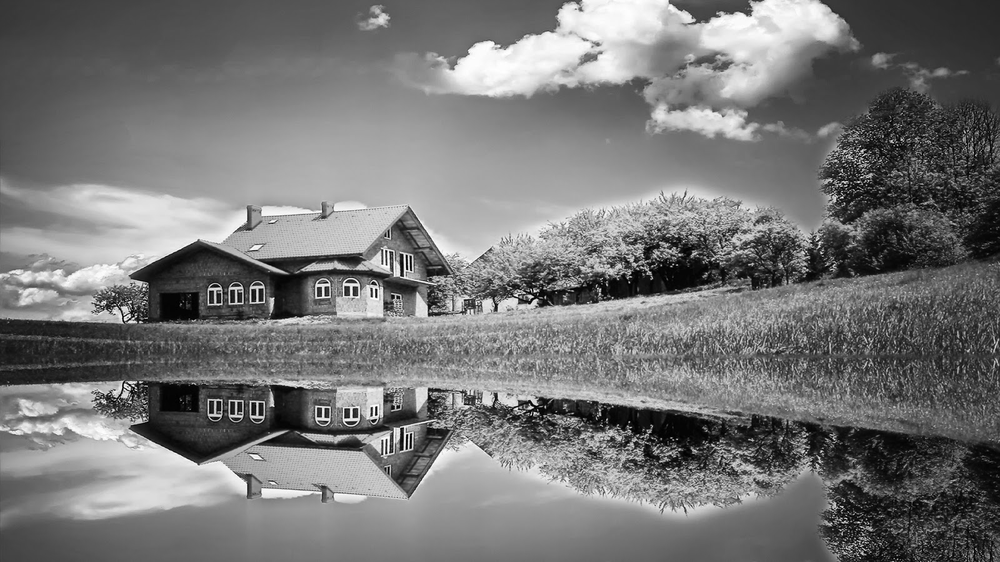

In [21]:
image = cv2.imread("img.jpg")
gray_cv2 = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

cv2_imshow(gray_cv2)

# 1.3

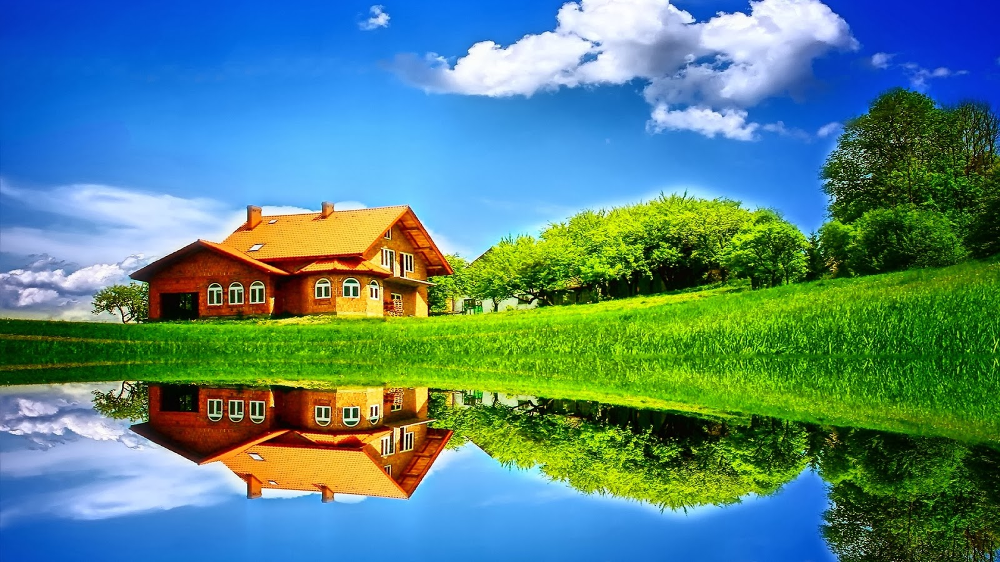

Resized to {resolution[0]}x{resolution[1]}


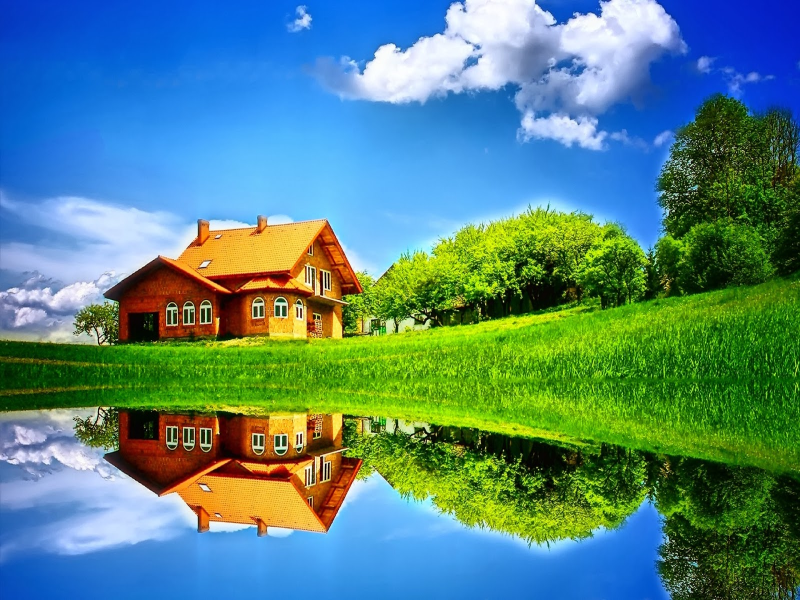

Resized to {resolution[0]}x{resolution[1]}


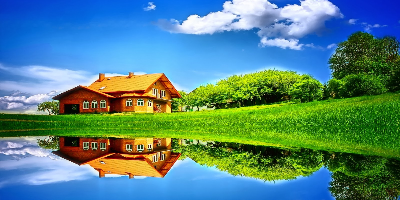

Resized to {resolution[0]}x{resolution[1]}


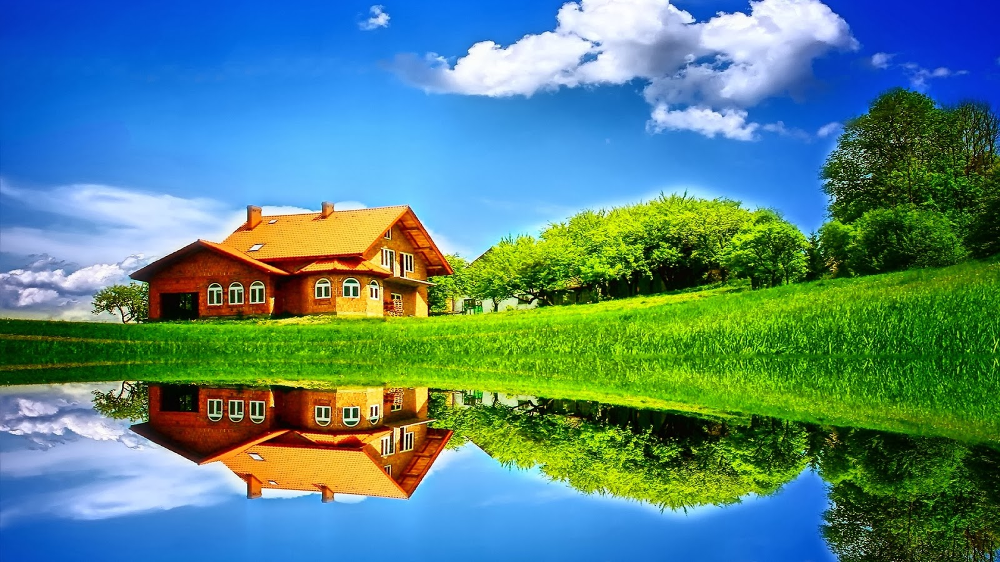

Resized to {resolution[0]}x{resolution[1]}


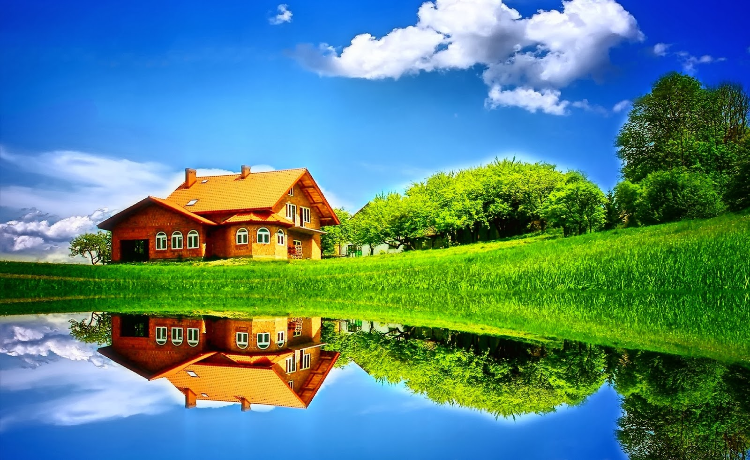

Resized to {resolution[0]}x{resolution[1]}


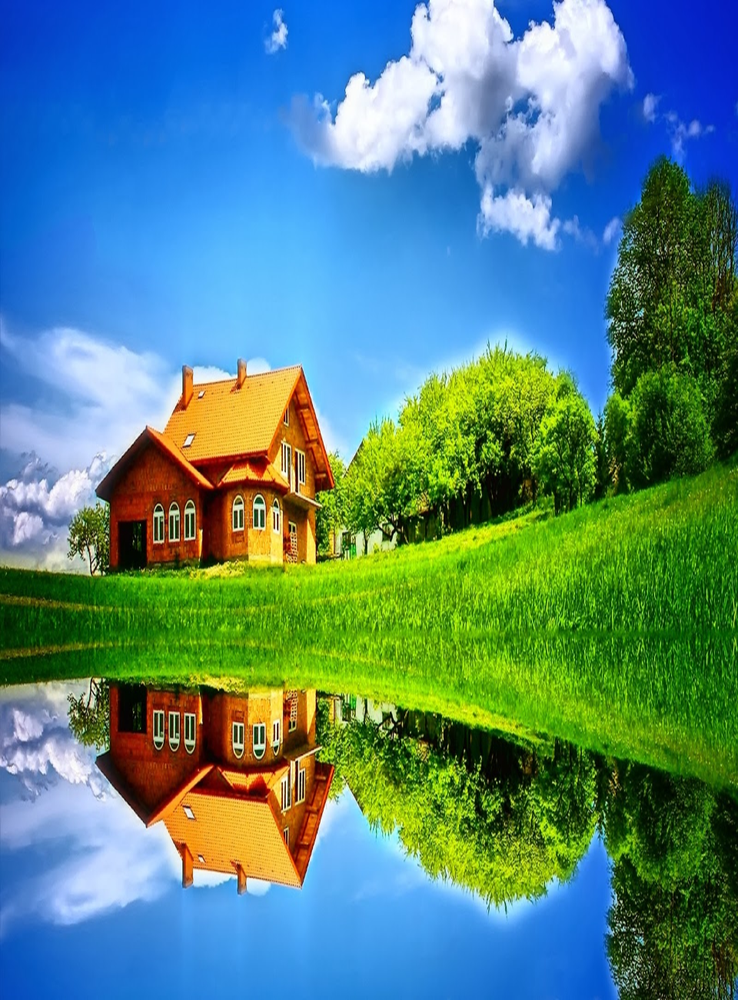

In [22]:
org_image = image
current_height, current_width, _ = org_image.shape
resolutions = [(800, 600), (400, 200), (1600, 900), (750, 460), (960, 1300)]

resized_images = []

for target_width, target_height in resolutions:

    scale_x = target_width / current_width
    scale_y = target_height / current_height
    resized_image = cv2.resize(org_image, (target_width, target_height), interpolation=cv2.INTER_LINEAR)
    resized_images.append(resized_image)

cv2_imshow(org_image)

for i, resolution in enumerate(resolutions):
    print("Resized to {resolution[0]}x{resolution[1]}")
    cv2_imshow(resized_images[i])


# 1.4

Resultant pixel at (10, 10): 250.00001525878906
Original Image


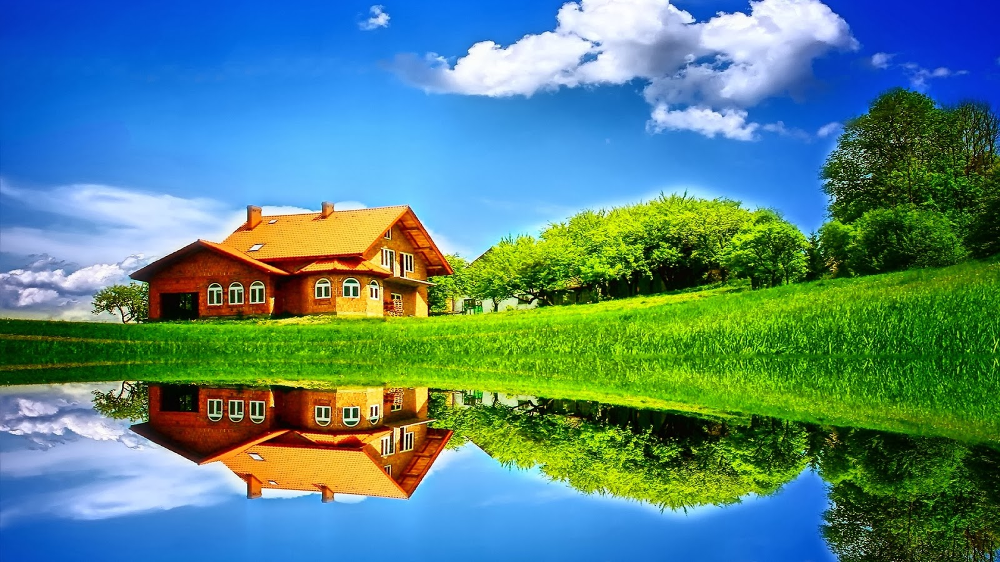

Blurred Image


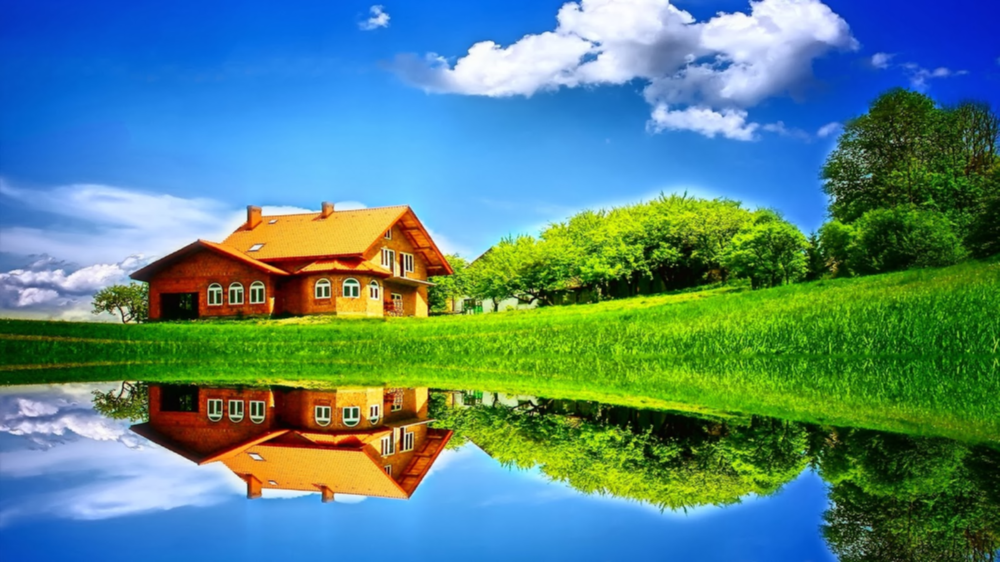

In [23]:
image_height, image_width, _ = image.shape
kernel = np.ones((3, 3), np.float32) / 9

kernel_height, kernel_width = kernel.shape

result_image = cv2.filter2D(image, -1, kernel)
x, y = 10, 10
region = image[y:y + kernel_height, x:x + kernel_width]
resultant_pixel = np.sum(region * kernel)

print(f"Resultant pixel at ({x}, {y}): {resultant_pixel}")

print("Original Image")
cv2_imshow( image)
print("Blurred Image")
cv2_imshow(result_image)

# 1.5